In [1]:
import numpy as np
import math as math
from qiskit.quantum_info.operators.pauli import Pauli
from qiskit_aqua.operator import Operator
from qiskit_aqua.algorithms import ExactEigensolver
from qiskit_aqua.algorithms.classical.cplex.cplex_ising import CPLEX_Ising
from collections import OrderedDict
import matplotlib.pyplot as plt 
import networkx as nx

C:\Users\javig\Anaconda3\envs\Qiskit\lib\site-packages\marshmallow\schema.py:364: ChangedInMarshmallow3Warning: strict=False is not recommended. In marshmallow 3.0, schemas will always be strict. See https://marshmallow.readthedocs.io/en/latest/upgrading.html#schemas-are-always-strict
  ChangedInMarshmallow3Warning


C:\Users\javig\Anaconda3\envs\Qiskit\lib\site-packages\networkx\drawing\nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


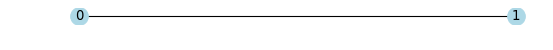

In [2]:
#n=100 Number of nodes                                                          
ncols=10 #Number of columns in a 10x10 grid of positions                        

N_col=2 #Nodes per row
N_row = 1 #Nodes por column

G=nx.grid_2d_graph(N_col, N_row, periodic=True)

pos = dict(zip(G.nodes(),G.nodes()))
ordering = [(x,N_row-1-y) for y in range(N_row) for x in range(N_col)]  

labels = dict(zip(ordering, range(len(ordering))))   

fig = plt.figure(figsize=(8, 8), dpi= 80, facecolor='w', edgecolor='k')

nx.draw_networkx(G, pos=pos, with_labels=False, node_size = 250, node_color='lightblue')                                                                       
nx.draw_networkx_labels(G, pos=pos, labels=labels)                              
plt.axis('off')     
plt.gca().set_aspect('equal', adjustable='box')

plt.show()

In [3]:
A = nx.to_numpy_matrix(G, nodelist=ordering)

print(A)

J = -1*np.ones(np.shape(A))
np.fill_diagonal(J, 0)
J = np.triu(J)

h = 0*np.ones(len(A))

[[0. 1.]
 [1. 0.]]


#### 1. Brute-froce method
This method does not require a Hamiltonian and it basically consists in exhaustively try all the binary assignments. In each binary assignment, the entry of a subset is either 0 (meaning the subset is not in the cover) or 1 (meaning the subset is in the cover). We print the binary assignment that satisfies the definition of the exact cover.

In [4]:
def brute_force(weight_matrix, J, h):
    # brute-force way: try every possible assignment!

    #First define a function which transforms a integer to a list whose elements are the binary digits of the number
    def bitfield(n, L):
        result = np.binary_repr(n, L)
        return np.array([int(digit) for digit in result])  # [2:] to chop off the "0b" part

    L = np.shape(weight_matrix)[0]
    max = 2**L
    #Try every possible combination and check if it is an exact cover

    def energy(sigma, weight_matrix, J, h):
        interaction = -((sigma@(np.multiply(weight_matrix, J)))@sigma).item(0)
        field = - h@sigma
        E = interaction + field 
        return E
    
    Ener = []
    sol = []
    for i in range(max):
        sig = bitfield(i, L)
        sig = sig - (sig==0)
        E = energy(sig, weight_matrix, J, h)
        Ener.append(E)
        sol.append(list(sig + (sig==-1)))
        
    Ener, sol = (list(t) for t in zip(*sorted(zip(Ener, sol))))
    Ener = np.array(Ener)
    sol = np.array([np.array(sol[i]) for i in range(len(sol))])
    
    return sol, Ener

sol, ener = brute_force(A, J, h)

C:\Users\javig\Anaconda3\envs\Qiskit\lib\site-packages\matplotlib\text.py:1191: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


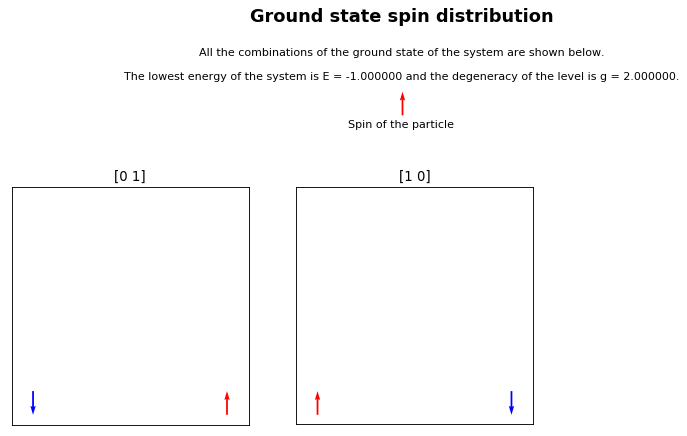

In [5]:
def ising_map(N_col, N_row, sol, ener=0):
    
    if (type(ener) == int) or (len(ener)==1):
        long = 1
    else:
        long = len(sol[ener==ener[0]])
    
    m = (math.ceil(long/3))/2
    
    fig = plt.figure(figsize=(13, 15*m), dpi= 80, facecolor='w', edgecolor='k')
    fig.subplots_adjust(top = 1-0.1/m, hspace=-0.2, wspace=0.2)
    
    xx = np.linspace(1,10, N_col)
    yy = np.linspace(1,10, N_row)
    
    (X,Y) = np.meshgrid(xx,yy)
    u =np.zeros(np.shape(X))
    
    colormap = plt.cm.bwr

    for i in range(0, long):
        if (type(ener) == int) or (len(ener)==1):
            isol = sol
        else:
            isol = sol[i]
            
        v = isol - (isol==0)
        v = v.reshape(np.shape(Y))
        c = isol*1.
        
        ax = fig.add_subplot(math.ceil(long/3), 3, i+1)
            
        ax.set_title(isol)
        
        q = plt.quiver(X,Y,u,v, color=colormap(c), angles='xy',scale=10, pivot = 'middle')
        
        if i == 0:
            p = plt.quiverkey(q, 0.5, 1-0.1/m, 1,"Spin of the particle",coordinates='figure',color='r', angle = 90, labelpos='S', labelsep=0.2)

        plt.xlim(0, 11)
        plt.ylim(0, 11)

        plt.gca().set_aspect('equal', adjustable='box')
        #plt.axis('off') 
        
        ax.set_yticklabels([])
        ax.set_xticklabels([])
        plt.xticks([])
        plt.yticks([])
        plt.gca().set_aspect('equal', adjustable='box')

    
    fig.suptitle('Ground state spin distribution', fontsize = 16, fontweight= 'bold', y= 1-0.3/(15*m))
    #plt.savefig('Error map km', bbox_inches = 'tight', pad_inches = 0.1)
    
    txt = 'All the combinations of the ground state of the system are shown below.' 
    fig.text(0.5, 1-0.9/(15*m), txt, ha='center')    
    try:
        txt2 = 'The lowest energy of the system is E = %f and the degeneracy of the level is g = %f.' % (ener[0], long)
        fig.text(0.5, 1-1.2/(15*m), txt2, ha='center')
        #fig.text(0.5, 0.15, txt2, ha='center')

    except:
        pass

    plt.show()

ising_map(N_col, N_row, sol, ener)

Note that for small graphs (smaller or equal than 3x3) border conditions take relevance resulting in a big degeneration, while for bigger scales border effect can be neglected.

#### 2. Classical way

In [6]:
class ising:
    def __init__(self):
        self.mu_0 = 1
    
    def get_ising_qubitops(self,weight_matrix, J, h):
        """
        Generate Hamiltonian for the ising model.

        Args:
            weight_matrix (numpy.ndarray) : adjacency matrix, J: interaction matrix, h: field array.

        Returns:
            operator.Operator, float: operator for the Hamiltonian and a
            constant shift for the obj function.
        """    
        num_nodes = weight_matrix.shape[0]
        pauli_list = []
        shift = 0
    
        for j in range(num_nodes):
            for i in range(j):
                if (weight_matrix[i,j] != 0):
                    wp = np.zeros(num_nodes)
                    vp = np.zeros(num_nodes)
                    vp[i] = 1
                    vp[j] = 1
                    pauli_list.append([-J[i, j], Pauli(vp, wp)])
                    #shift -= J * weight_matrix[i, j]
            up = np.zeros(num_nodes)
            wp = np.zeros(num_nodes)
            up[j] = 1
            pauli_list.append([-h[j]*self.mu_0, Pauli(up, wp)])        
        
        return Operator(paulis=pauli_list), shift

    def sample_most_likely(self, state_vector):
        """Compute the most likely binary string from state vector.
        Args:
            state_vector (numpy.ndarray or dict): state vector or counts.
        Returns:
            numpy.ndarray: binary string as numpy.ndarray of ints.
        """
        if isinstance(state_vector, dict) or isinstance(state_vector, OrderedDict):
        # get the binary string with the largest count
            binary_string = sorted(state_vector.items(), key=lambda kv: kv[1])[-1][0]
            x = np.asarray([int(y) for y in reversed(list(binary_string))])
            return x
        else:
            n = int(np.log2(state_vector.shape[0]))
            k = np.argmax(np.abs(state_vector))
            u = np.binary_repr(k, width=n)
            x = np.array([ int(u[j]) for j in range(n)])
            return x

    
    def get_solution(self, x):
        """Compute the most likely binary string from state vector.
        Args:
            state_vector (numpy.ndarray or dict): state vector or counts.
        Returns:
            numpy.ndarray: binary string as numpy.ndarray of ints.
        """
        x = np.array([1 - x[i] for i in range(len(x))])
        return x

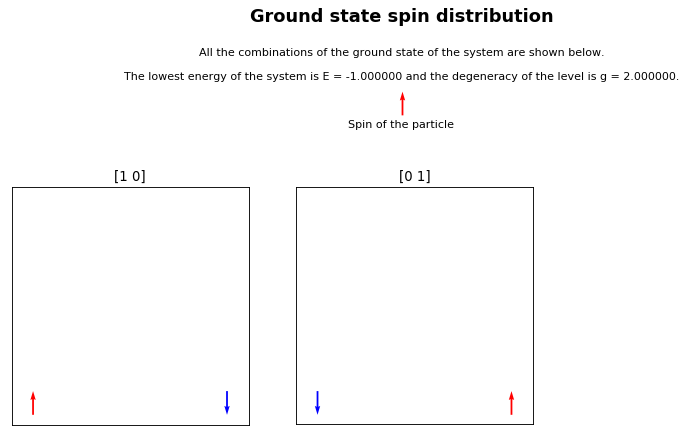

In [7]:
ising = ising()
qubitOp, offset = ising.get_ising_qubitops(A, J, h)

algo = ExactEigensolver(qubitOp, k=2**(N_col*N_row), aux_operators=[])
result = algo.run()

x = [ ising.sample_most_likely(result['eigvecs'][i]) for i in range(len(result['eigvecs'])) ]
ising_sol = ising.get_solution(x)

ising_map(N_col, N_row, ising_sol, result['eigvals'])

C:\Users\javig\Anaconda3\envs\Qiskit\lib\site-packages\qiskit_aqua\components\optimizers\JAVI.py:92: OptimizeWarning: Unknown solver options: rhobeg
  res = minimize(objective_function, initial_point, callback=self.callbackF, tol=self._tol, method="SLSQP", options=self._options)
C:\Users\javig\Anaconda3\envs\Qiskit\lib\site-packages\marshmallow\schema.py:364: ChangedInMarshmallow3Warning: strict=False is not recommended. In marshmallow 3.0, schemas will always be strict. See https://marshmallow.readthedocs.io/en/latest/upgrading.html#schemas-are-always-strict
  ChangedInMarshmallow3Warning


{'eval_count': 62, 'eigvals': array([-1.]), 'opt_params': array([-1.68983   ,  0.79856104,  0.6427723 ,  1.44095475, -0.81573064,
        0.20792836, -2.45423396, -1.78745189]), 'eval_time': 3.7659432888031006, 'eigvecs': array([[-3.56637198e-06+0.j, -6.24409501e-01+0.j,  7.81097161e-01+0.j,
         4.32208936e-06+0.j]]), 'energy': -0.9999999999372015}


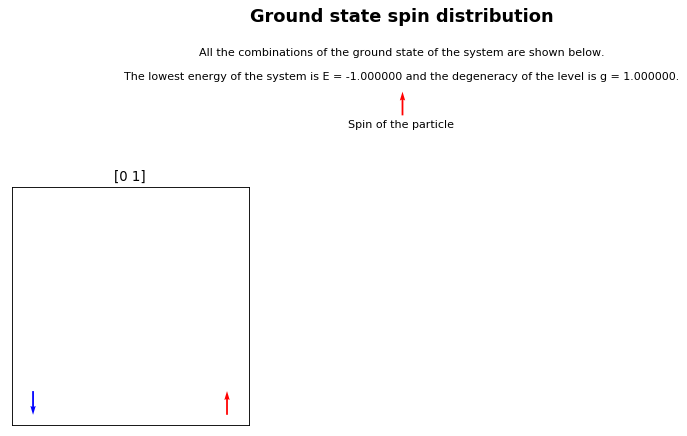

In [8]:
from qiskit import Aer
from qiskit_aqua import run_algorithm
from qiskit_aqua.input import EnergyInput

algo_input = EnergyInput(qubitOp)

#The Variational-Quantum-Eigensolver (VQE) algorithm is selected

algorithm_cfg = {
    'name': 'VQE',
    'operator_mode': 'paulis'
}

#Constrained optimization by linear approximation (COBYLA) is a numerical optimization method for constrained problems 
#where the derivative of the objective function is not known.
#https://en.wikipedia.org/wiki/COBYLA

optimizer_cfg = {
    'name': 'JAVI',
}

#The RyRz trial wave function is layers of y plus z rotations with entanglements.
#https://qiskit.org/documentation/aqua/variational_forms.html

var_form_cfg = {
    'name': 'RY',
    'depth': 3,
    'entanglement' : "linear"
}

initial_states = {
    'name': 'ZERO'
}

#Now the params are defined
params = {
    'problem': {'name': 'ising', 'random_seed': 10598},
    'algorithm': algorithm_cfg,
    'optimizer': optimizer_cfg,
    'variational_form': var_form_cfg,
    'initial_state': initial_states
}

#Finally we use the 'statevector_simulator' backend to simulate
backend = Aer.get_backend('statevector_simulator')

result = run_algorithm(params, algo_input, backend=backend)
print(result)

x = ising.sample_most_likely(result['eigvecs'][0])

ising_sol = ising.get_solution(x)

ising_map(N_col, N_row, ising_sol, result['eigvals'])

Uno puede pensar que la función de onda final será una combinación de todas las posibles soluciones. Sin embargo, esto no es así pues los optimizadores se encargan de buscar una única solución. Encontrarlas todas supone un problema que se encuentra fuera de NP-hard, está en PSPACE (creo, según juanjo).

In [9]:
print('The energy expected for the ground state is %f J (¿son julios realmente?) and the energy of the final state is %f J.' % (ener[0], result['eigvals']))
print('This means that there is a relative error in the energy of the ground state of %.2e J, due to the noise registered by the population of other states.' % (abs(ener[0]-result['eigvals'])/abs(ener[0])))

The energy expected for the ground state is -1.000000 J (¿son julios realmente?) and the energy of the final state is -1.000000 J.
This means that there is a relative error in the energy of the ground state of 6.28e-11 J, due to the noise registered by the population of other states.


In [10]:
par = []

with open("Intermediate parameters", "r") as f:
    for line in f:
        par.append(float(line.strip()))

parameter = []

for i in range(0, len(par), len(result['opt_params'])):
    parameter.append(np.array(par[i:i + len(result['opt_params'])]))

In [11]:
from qiskit_aqua.components.variational_forms.ry import RY
from qiskit_aqua.components.variational_forms.ryrz import RYRZ

import numpy as np

num_qubits = N_col*N_row
depth = var_form_cfg['depth']
entanglement = var_form_cfg['entanglement']
type_of_variation = var_form_cfg['name']

if type_of_variation == 'RY':
    circ = RY(num_qubits, depth=depth, entanglement=entanglement)
elif type_of_variation == 'RYRZ':
    circ = RYRZ(num_qubits, depth=depth, entanglement=entanglement)
    
#print(circ.construct_circuit(parameter[0]))

In [12]:
from qiskit import BasicAer, execute
#from qiskit import execute

def outputstate(circ):
    backend = BasicAer.get_backend('statevector_simulator')
    # Create a Quantum Program for execution 
    job = execute(circ, backend)
    result = job.result()
    outputstate = result.get_statevector(circ, decimals=3)
    return outputstate

output = []
for par in parameter:
    circuit = circ.construct_circuit(par)
    output.append(outputstate(circuit))

In [13]:
#Lets visualize the density matrix.
from qiskit.tools.visualization import plot_state_city
import os
import shutil

path1 = os.getcwd()
path2 = path1+'\density'

shutil.rmtree(path2, ignore_errors=True)
os.mkdir(path2)
os.chdir(path2)

for i in range(len(output)):
    fig = plot_state_city(output[i])
    fig.savefig('density' + str(i)+ '.png')

os.chdir(path1)

In [14]:
import imageio
import os, sys
import glob

dataDir = path2

os.chdir(dataDir)
fileList = glob.glob(dataDir + '\*.png')
fileList.sort(key=lambda s: int(s[58:-4]))

images = []

for filename in fileList:
    images.append(imageio.imread(filename))
    
kargs = { 'fps': 1 }    

imageio.mimsave('density_movie.gif', images, **kargs)

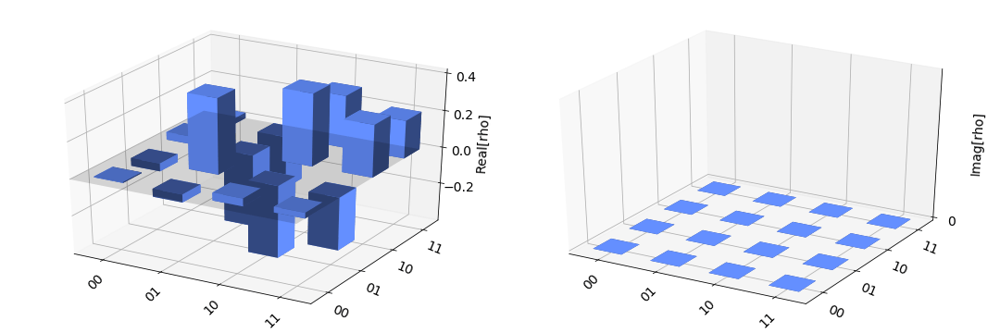

In [15]:
from IPython.display import Image
Image(filename="density_movie.gif")

In [16]:
from numpy.linalg import svd as svd

def entropy(phi):
    a = np.reshape(np.array(phi), tuple([2]*num_qubits))
    h = svd(a)
    eigval = h[1]
    logarithm = np.ma.log2(eigval)
    logarithm = np.ma.filled(logarithm, 0)
    s = eigval * logarithm
    return -np.sum(s)

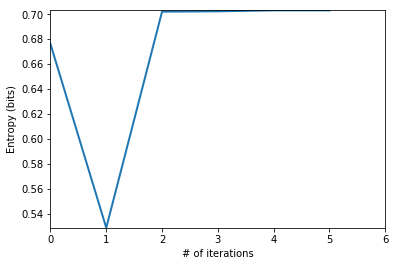

In [17]:
from matplotlib import animation, rc
from IPython.display import HTML

#Get entropy
S = []

for out in output:
    S.append(entropy(out))
    
# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots()

ax.set_xlim(( 0, len(S)))
ax.set_ylim((min(S), max(S)))
ax.set_xlabel('# of iterations')
ax.set_ylabel('Entropy (bits)')

line, = ax.plot([], [], lw=2)

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return (line,)

# animation function. This is called sequentially
def animate(i):
    x = range(0, i+1)
    y = S[0:i+1]
    line.set_data(x, y)
    return (line,)

# call the animator. blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(S), interval=1000, blit=True)
os.chdir(path2)
anim.save('entropy.gif', writer='imagemagick', fps=1)

HTML(anim.to_html5_video())

MoviePy - Building file sinc_plot.gif with imageio.


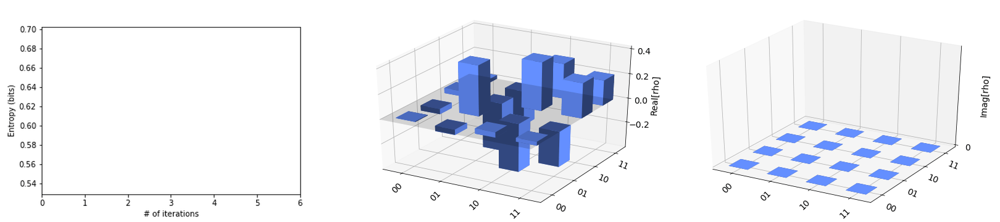

In [18]:
import moviepy.editor as mpy
# We use the GIFs generated earlier to avoid recomputing the animations.
clip_mayavi = mpy.VideoFileClip("density_movie.gif")
clip_mpl = mpy.VideoFileClip("entropy.gif").resize(height=clip_mayavi.h)
animation = mpy.clips_array([[clip_mpl, clip_mayavi]])
animation.write_gif("sinc_plot.gif", fps=20)

Image(filename="sinc_plot.gif")

## Bibliography

**[1]** Pathria, R. K., & Beale, P. D. Statistical mechanics. 2011.

**[2]** Arovas, D. (2013). Lecture notes on thermodynamics and statistical mechanics.

**[3]** MIT OpenCourseWare. (2014, April). Transfer Matrices & Position space renormalization. Retrieved February 15, 2019.

https://github.com/Qiskit/qiskit-aqua/blob/7e39e4cff5f69c1b0d8e55532df45e0b1bd72c81/qiskit_acqua/ising/maxcut.py